# SUPPORT VECTOR MACHINES: IRIS FLOWER PROJECT

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

In [4]:
%matplotlib inline

In [8]:
#The iris dataset or Fischers data set is a multivariata data set introduced by 
#Sir Ronals Fischer in the 1936 as an exapmle of discriminant analysis

#The data set consists of 60 samples each of three species Iris(Iris setosa,
#Iris virginica  and Iris versicolor) and so total 150 samples. Four features 
#are measured from each sample: the length and the width of the samples and 
#petals(Blütenblatt) in centimeters

#The iris dataset contains measurement for 150 iris flowers from three different species
#The three classes in the iris dataset
#   Iris setosa(n=50)
#   Iris versicolor(n=50)
#   Iris virginica(n=50)

#The four features
#   sepal length in cm
#   sepal width in cm
#   petak length in cm
#   sepal width in cm


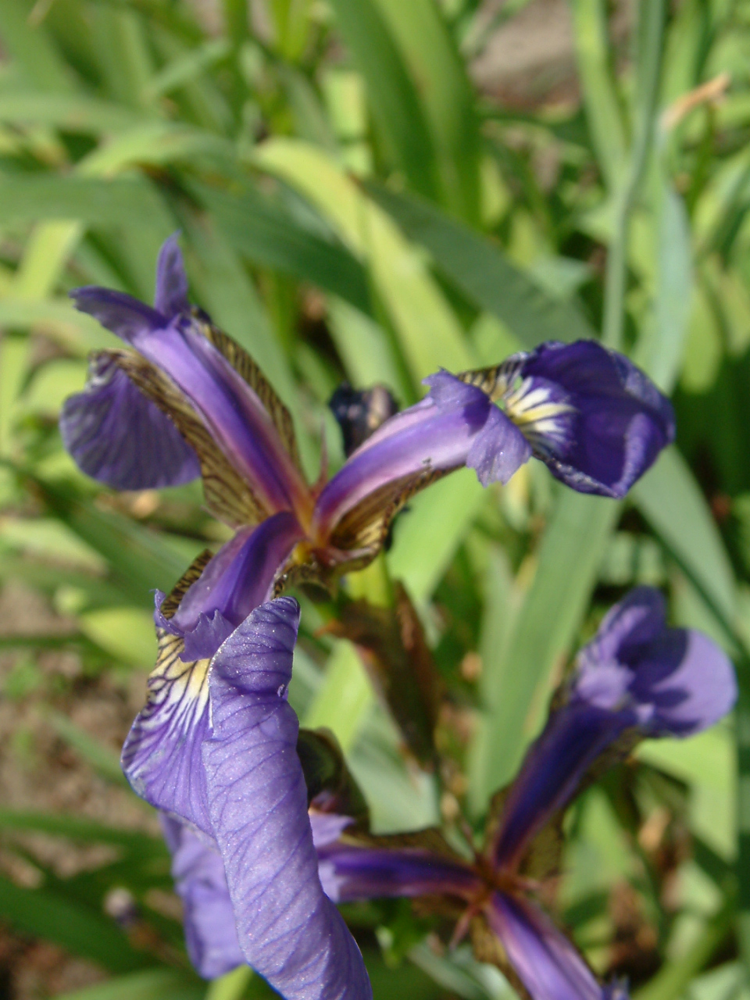

In [5]:
#Iris Setosa
from IPython.display import Image
url = 'https://upload.wikimedia.org/wikipedia/commons/5/56/Kosaciec_szczecinkowaty_Iris_setosa.jpg'
Image(url,width=300,height=300)

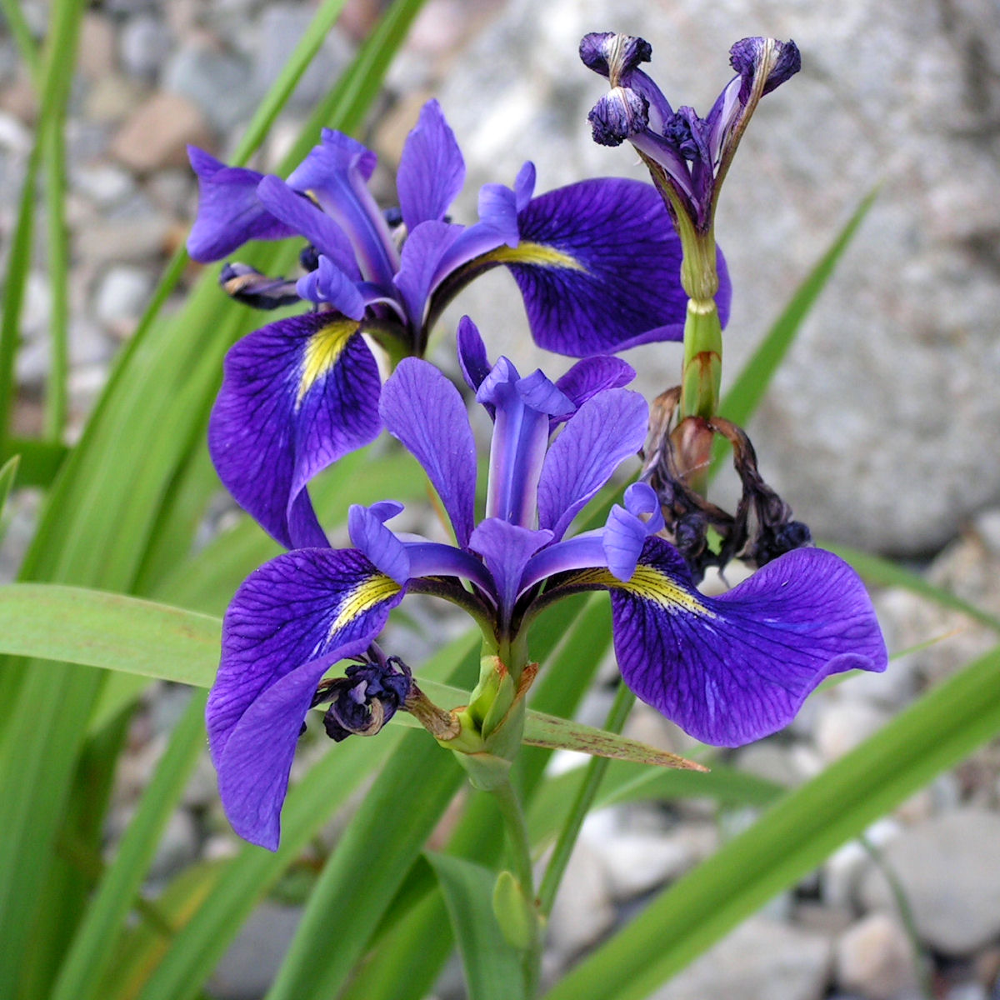

In [6]:
#Iris Versicolor
from IPython.display import Image
url = 'https://upload.wikimedia.org/wikipedia/commons/2/27/Blue_Flag%2C_Ottawa.jpg'
Image(url,width=300,height=300)

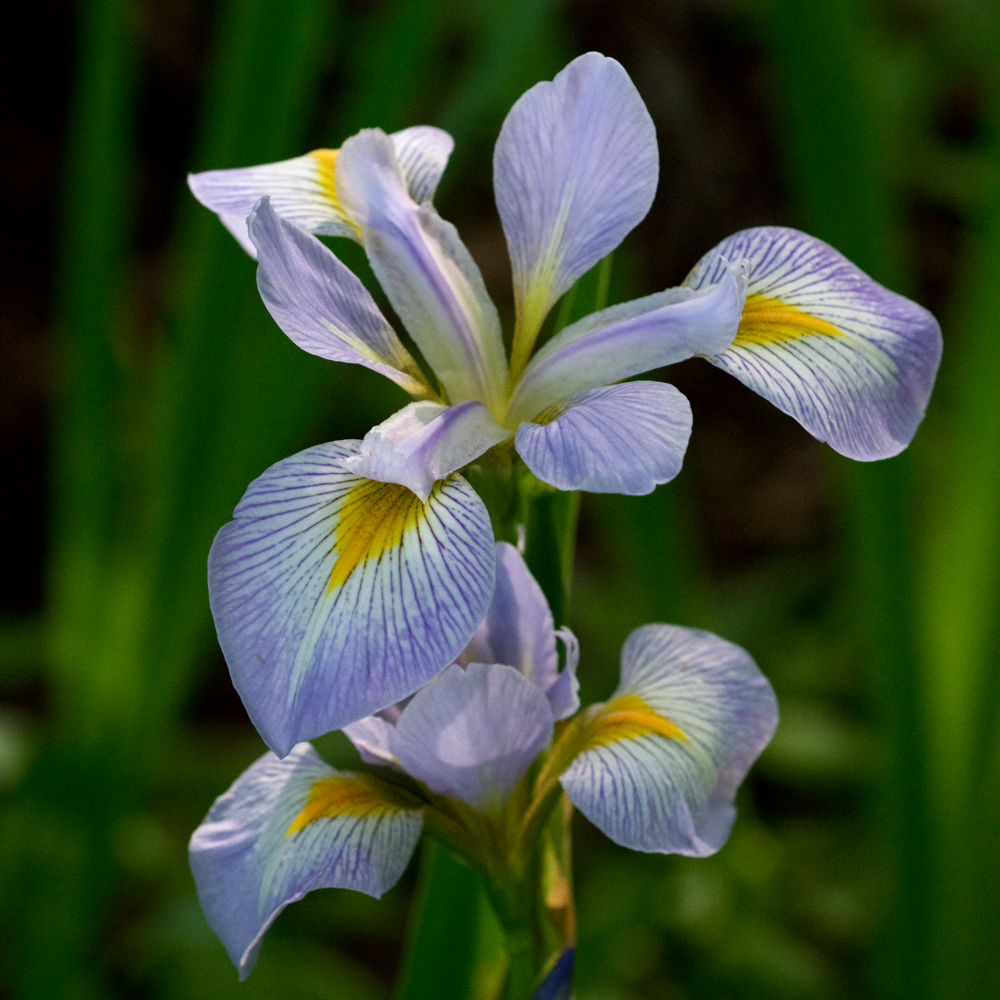

In [7]:
#Iris Versicolor
from IPython.display import Image
url = 'https://upload.wikimedia.org/wikipedia/commons/f/f8/Iris_virginica_2.jpg'
Image(url,width=300,height=300)

## Loading the iris data set 

In [8]:
iris = sns.load_dataset('iris')

In [13]:
iris.head()

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa


In [9]:
iris.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 5 columns):
sepal_length    150 non-null float64
sepal_width     150 non-null float64
petal_length    150 non-null float64
petal_width     150 non-null float64
species         150 non-null object
dtypes: float64(4), object(1)
memory usage: 5.9+ KB


In [10]:
iris.describe()

,sepal_length,sepal_width,petal_length,petal_width
count,150.000000,150.000000,150.000000,150.000000
mean,5.843333,3.057333,3.758000,1.199333
std,0.828066,0.435866,1.765298,0.762238
min,4.300000,2.000000,1.000000,0.100000
25%,5.100000,2.800000,1.600000,0.300000
50%,5.800000,3.000000,4.350000,1.300000
75%,6.400000,3.300000,5.100000,1.800000
max,7.900000,4.400000,6.900000,2.500000


## Simple data analysis

In [11]:
sns.set_style('whitegrid')

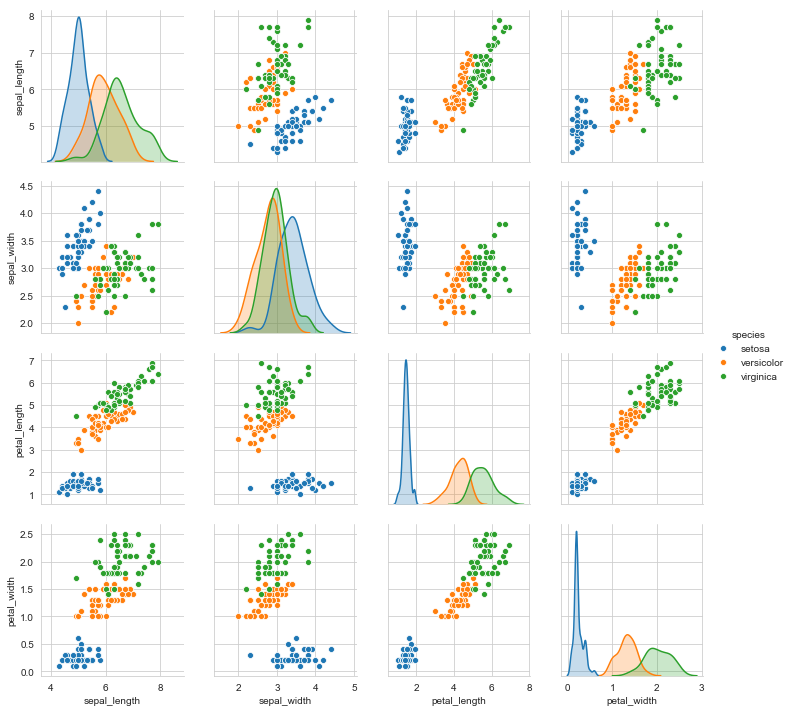

In [12]:
sns.pairplot(iris,hue='species')

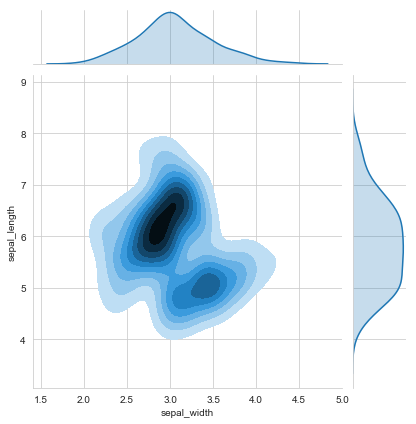

In [23]:
sns.jointplot(x='sepal_width',y='sepal_length',data=iris,
              kind='kde',shade_lowest=False)

/home/faruk/anaconda3/lib/python3.7/site-packages/matplotlib/contour.py:1000: UserWarning: The following kwargs were not used by contour: 'shades'
  s)


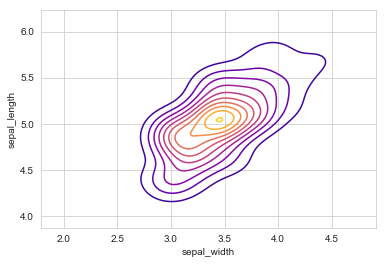

In [20]:
setosa = iris[iris['species']=='setosa']
sns.kdeplot(setosa['sepal_width'],setosa['sepal_length'],
            cmap='plasma',shades=True,shade_lowest=False)

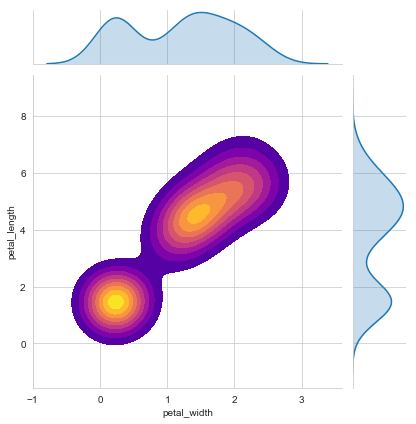

In [22]:
sns.jointplot(x='petal_width',y='petal_length',data=iris,
              kind='kde',cmap='plasma',shade_lowest=False)

## Test train split od the iris data

In [29]:
from sklearn.model_selection import train_test_split

In [30]:
X = iris[['sepal_length', 'sepal_width', 'petal_length', 'petal_width']]
#X=iris.drop('species')
y = iris['species']

In [31]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=101)

## Setting the model: support vector classifier

In [32]:
from sklearn.svm import SVC

In [33]:
model = SVC()

## Train and fit the data to the model

In [34]:
model.fit(X_train,y_train)

/home/faruk/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)


SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
    kernel='rbf', max_iter=-1, probability=False, random_state=None,
    shrinking=True, tol=0.001, verbose=False)

## Prediction test and evaluation of the model

In [35]:
predictions_svm = model.predict(X_test)

In [36]:
from sklearn.metrics import confusion_matrix, classification_report

In [37]:
print(confusion_matrix(y_test,predictions_svm))

[[13  0  0]
 [ 0 20  0]
 [ 0  0 12]]


In [38]:
print(classification_report(y_test,predictions_svm))

              precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        13
  versicolor       1.00      1.00      1.00        20
   virginica       1.00      1.00      1.00        12

    accuracy                           1.00        45
   macro avg       1.00      1.00      1.00        45
weighted avg       1.00      1.00      1.00        45



In [39]:
predictions_svm

array(['setosa', 'setosa', 'setosa', 'virginica', 'versicolor',
       'virginica', 'versicolor', 'versicolor', 'virginica', 'setosa',
       'virginica', 'setosa', 'setosa', 'virginica', 'virginica',
       'versicolor', 'versicolor', 'versicolor', 'setosa', 'virginica',
       'versicolor', 'setosa', 'versicolor', 'versicolor', 'versicolor',
       'versicolor', 'versicolor', 'virginica', 'setosa', 'setosa',
       'virginica', 'versicolor', 'virginica', 'versicolor', 'virginica',
       'versicolor', 'versicolor', 'versicolor', 'versicolor',
       'virginica', 'setosa', 'setosa', 'setosa', 'versicolor',
       'versicolor'], dtype=object)

## Gridsearch Practice

In [46]:
#In the confusion matrix we see that the model things everything in a class
#the reason we have to adjust the parameters of the model and it may help 
#to normalize the data

#Finding the best parameters using a grid search. A grid search allows you to find 
#the right parameters such what c and gamma values we use

In [40]:
from sklearn.model_selection import GridSearchCV

In [41]:
param_grid = {'C':[0.1,1,10,100,1000],'gamma':[1,0.1,0.01,0.001,0.0001]}

In [42]:
grid = GridSearchCV(SVC(),param_grid, verbose=3)

In [43]:
grid.fit(X_train,y_train)

/home/faruk/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:1978: FutureWarning: The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.
  warnings.warn(CV_WARNING, FutureWarning)
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s


Fitting 3 folds for each of 25 candidates, totalling 75 fits
[CV] C=0.1, gamma=1 ..................................................
[CV] ...................... C=0.1, gamma=1, score=0.917, total=   0.0s
[CV] C=0.1, gamma=1 ..................................................
[CV] ...................... C=0.1, gamma=1, score=0.914, total=   0.0s
[CV] C=0.1, gamma=1 ..................................................
[CV] ...................... C=0.1, gamma=1, score=0.882, total=   0.0s
[CV] C=0.1, gamma=0.1 ................................................
[CV] .................... C=0.1, gamma=0.1, score=0.750, total=   0.0s
[CV] C=0.1, gamma=0.1 ................................................
[CV] .................... C=0.1, gamma=0.1, score=0.771, total=   0.0s
[CV] C=0.1, gamma=0.1 ................................................
[CV] .................... C=0.1, gamma=0.1, score=0.765, total=   0.0s
[CV] C=0.1, gamma=0.01 ...............................................
[CV] ...........

[Parallel(n_jobs=1)]: Done  75 out of  75 | elapsed:    0.3s finished
/home/faruk/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_search.py:813: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


GridSearchCV(cv='warn', error_score='raise-deprecating',
             estimator=SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
                           decision_function_shape='ovr', degree=3,
                           gamma='auto_deprecated', kernel='rbf', max_iter=-1,
                           probability=False, random_state=None, shrinking=True,
                           tol=0.001, verbose=False),
             iid='warn', n_jobs=None,
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001]},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=3)

In [46]:
grid_predictions = grid.predict(X_test)

In [47]:
print(confusion_matrix(y_test,grid_predictions))

[[13  0  0]
 [ 0 19  1]
 [ 0  0 12]]


In [48]:
print(classification_report(y_test,grid_predictions))

              precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        13
  versicolor       1.00      0.95      0.97        20
   virginica       0.92      1.00      0.96        12

    accuracy                           0.98        45
   macro avg       0.97      0.98      0.98        45
weighted avg       0.98      0.98      0.98        45

